In [1]:
#importing necessary libraries 
from tqdm import tqdm
import h5py
import numpy as np
import bitshuffle.h5
import pandas as pd
import seaborn as sns
from matplotlib import rc
from pylab import rcParams
import re
%matplotlib inline
%config InlineBackend.figure_format='retina'

# just set the style of the plots
sns.set(palette='muted', font_scale=1.2)
sns.set_style("whitegrid", {'axes.grid' : False})
HAPPY_COLORS_PALETTE = ["#01BEFE", "#FFDD00", "#FF7D00", "#FF006D", "#ADFF02", "#8F00FF"]
sns.set_palette(sns.color_palette(HAPPY_COLORS_PALETTE))
rcParams['figure.figsize'] = 12, 8

from PIL import Image
import math

import warnings
warnings.filterwarnings('ignore')
warnings.simplefilter('ignore')
import matplotlib.pyplot as plt




from scipy.spatial import distance
from sklearn.metrics import mean_squared_error
from scipy.optimize import linear_sum_assignment

# FUNCTIONS

In [60]:
# Get a poriton of the image around the spot
# dx is the amount of pixels to wrap around the spot
def get_range(spot,img_raw,dx=4):
    # check always that X and Y are inverted!!!!!
    # if we don't invert them befor we should do it here
    x=int(np.round(spot[1]))
    y=int(np.round(spot[0]))
    
    # set the boundaries
    (MAX_X, MAX_Y) = img_raw.shape
    (MIN_X, MIN_Y) = (0,0)

    # Get the range
    (xi,xf),(yi,yf)=(x-dx,x+dx),(y-dx,y+dx)
    
    # get the patch from the raw image
    # first check if the border of the image are within the image
    if xi!=max(MIN_X,xi) or yi!=max(MIN_Y,yi) or xf!=min(MAX_X,xf) or yf!=min(MAX_Y,yf):
        # if dx bring us out of the image just pad the result with zeros
        tmppatch=img_raw[max(MIN_X,xi):(min(MAX_X,xf)+1),max(MIN_Y,yi):(min(MAX_Y,yf)+1)]
        patch=np.zeros((dx*2+1,dx*2+1))
        (xf,yf)=tmppatch.shape
        patch[:xf,:yf]=tmppatch
    else:
        patch=img_raw[xi:(xf+1),yi:(yf+1)]
    
    return patch

def clean_image(imfull):
    # cast the image to signed integers
    im0=imfull.astype(np.int32)
    # remove mask and bad pixels
    im0[np.where(im0<0)]=0
    
    if np.max(im0)>65534:
        # in case there are real spot with counts>65634
        # saturate to 65535 for now to use np.uint16
        im0[np.where(im0>65534)]=65534
    
    return im0.astype(np.uint16)



### Ceate frame/spot dictionary

# Just round up and down the time, we can extend this to a larger time window
def round_time(raw_spots,dt=0):
    # try to remove duplicates
    # set_of_floats=set(list(map(tuple,raw_spots[:,:3])))
    max_frame=int(np.max(raw_spots[:,2]))
    expanded_list=[]
    for spot in raw_spots:
        # round to the time to the earest integer
        rounded=np.round(spot[2])
        # set the lower bound
        min_round=max(0,rounded-dt)
        # set the upper bound
        max_round=min(rounded+dt+1,max_frame+1)
        
        for new_time in np.arange(min_round,max_round):
            expanded_list.append((spot[0], spot[1], new_time))
        
    return np.asarray(expanded_list)

def match_spots_frame_expanded(predicted,n_frame):
    '''
    Given the list of spots found by XDS and a specific frame number, 
    return the list of centers found matching the frame number given
    '''
    # find all the spots in the same frame
    idx_rows=np.where(list(map(int,predicted[:,2]))==n_frame)
    tmp_list=predicted[idx_rows,([0],[1])].T
    
    # I use set to remove possible duplicates
    return np.asarray(list(set(list(map(tuple,tmp_list)))))


def get_list_spots_fromfile(filename,timerounded=False,shift_min=True,dt=3):
    '''
    Load spot centers from a file and return a dictionary where each key
    is a frame number
    '''
    from collections import defaultdict
    dict_spots = defaultdict(lambda: [])
    spots_reflections_raw=np.loadtxt(filename)
    # round only time up and down
    if timerounded:
        spots_reflections_raw=round_time(spots_reflections_raw,dt)
    
    # get unique frames
    # frames=set(rounded_spots[:,2])
    frames=set(spots_reflections_raw[:,2].astype(int))
    min_framenum=0
    if shift_min:
        min_framenum=min(frames)
    
    for fr in tqdm(frames):
        dict_spots[fr-min_framenum]=match_spots_frame_expanded(spots_reflections_raw,fr)
    
    return dict_spots

# COMPARE LIST OF SPOTS

def get_matching_pairs(reference, list_to_match,max_disdance=20):
    from sklearn.neighbors import NearestNeighbors
    nbrs = NearestNeighbors(n_neighbors=1, algorithm='ball_tree').fit(list_to_match)
    distances, indices = nbrs.kneighbors(reference)
    
    # Reshape the list of arrays into np.arrays
    indices=np.asarray(indices).reshape(-1)
    distances=np.asarray(distances).reshape(-1)
    
    # select pairs with distance lower than max_distance
    matched_idx=np.where(distances<max_disdance)[0]
    
    return np.arange(len(reference))[matched_idx], indices[matched_idx]

def get_metrics(strong,predicted,max_overlap=20):
    # Get the TP
    (matched_pred,matched_str)=get_matching_pairs(predicted, strong,max_disdance=max_overlap)
    TP=strong[matched_str]
    
    #Get the FN
    complementset_PRED=np.asarray(list(set(range(len(predicted))).difference(set(matched_pred))))
    # spots not detected by the spotfinder but present in the list of 'real' predicted spot
    FN=[]
    if len(complementset_PRED)>0:
        FN=predicted[complementset_PRED]
    
    # Get the FP
    # spots detected by the spotfinder but not present in the list of 'real' predicted spot
    complementset_SPOTFINDER=np.asarray(list(set(range(len(strong))).difference(set(matched_str))))
    # False positive
    FP=[]
    if len(complementset_SPOTFINDER)>0:
        FP=strong[complementset_SPOTFINDER]
    
    # Compute the scoring metrics
    precision_score=len(TP)/(len(FP)+len(TP))
    recall_score=len(TP)/(len(TP)+len(FN))
    f1_score=2*(precision_score*recall_score)/(precision_score+recall_score)
    #f1_score=len(TP)/(len(TP)+ (len(FP)+len(FN))/2)
    
    return f1_score, precision_score, recall_score, len(FP)


def get_metrics_full(strong,predicted,max_overlap=20):
    # Get the TP
    (matched_pred,matched_str)=get_matching_pairs(predicted, strong,max_disdance=max_overlap)
    TP=strong[matched_str]
    
    #Get the FN
    complementset_PRED=np.asarray(list(set(range(len(predicted))).difference(set(matched_pred))))
    # spots not detected by the spotfinder but present in the list of 'real' predicted spot
    FN=[]
    if len(complementset_PRED)>0:
        FN=predicted[complementset_PRED]
    
    # Get the FP
    # spots detected by the spotfinder but not present in the list of 'real' predicted spot
    complementset_SPOTFINDER=np.asarray(list(set(range(len(strong))).difference(set(matched_str))))
    # False positive
    FP=[]
    if len(complementset_SPOTFINDER)>0:
        FP=strong[complementset_SPOTFINDER]
    
    # Compute the scoring metrics
    precision_score=len(TP)/(len(FP)+len(TP))
    recall_score=len(TP)/(len(TP)+len(FN))
    f1_score=2*(precision_score*recall_score)/(precision_score+recall_score)
    #f1_score=len(TP)/(len(TP)+ (len(FP)+len(FN))/2)
    
    return f1_score, precision_score, recall_score, len(TP), len(FP), len(FN)

# LOAD PREDICTIONS AND SPOTFINDER SPOTS

In [3]:
import glob
import re
mylist=glob.glob("*h5")
r=re.compile("^[a-zA-Z0-9].*0...h5")
data_files=sorted(list(filter(r.match, mylist)))
data_files

['Lyso_19_2_data_000001.h5',
 'Lyso_19_2_data_000002.h5',
 'Lyso_19_2_data_000003.h5',
 'Lyso_19_2_data_000004.h5',
 'Lyso_19_2_data_000005.h5',
 'Lyso_19_2_data_000006.h5',
 'Lyso_19_2_data_000007.h5',
 'Lyso_19_2_data_000008.h5',
 'Lyso_19_2_data_000009.h5']

In [4]:
# Load spots list and round the time up and down

# Round strong reflections only in one window
# Don't round strong reflections
spots_reflections=get_list_spots_fromfile("strrfl_XDS",timerounded=True,dt=1)

# Round the time up and down in a window of 2 for predicted reflections
predicted_reflections=get_list_spots_fromfile("pred_XDS",timerounded=True,dt=3)

100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 900/900 [01:58<00:00,  7.62it/s]


NameError: name 'MINIBATCH_NUM' is not defined

<AxesSubplot:xlabel='len(PREDICTED)/len(COLSPOT) per frame', ylabel='Density'>

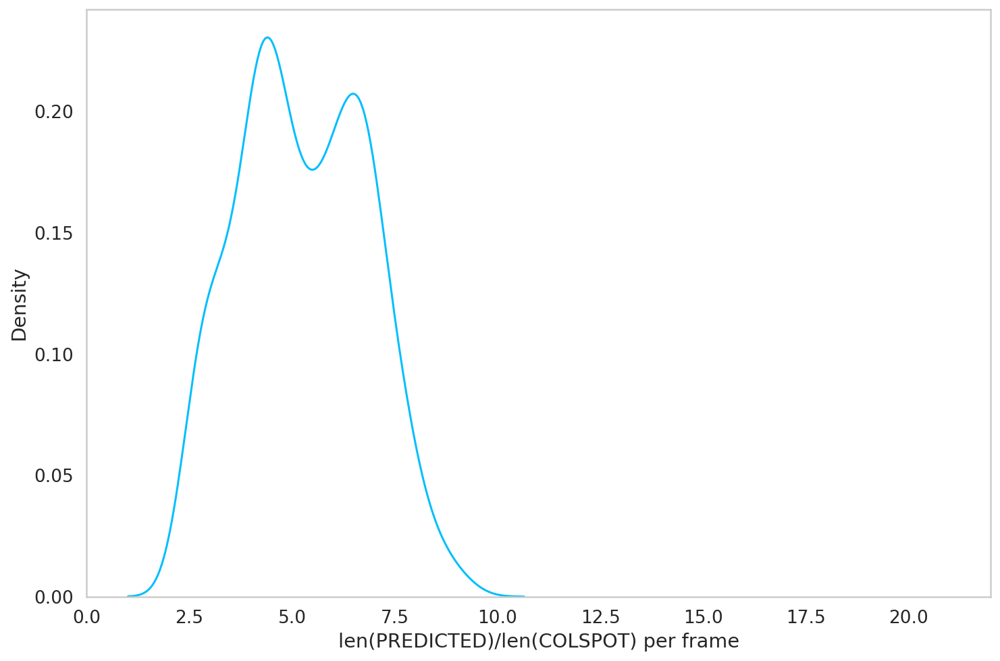

In [6]:
import seaborn as sns

plt.xlabel("len(PREDICTED)/len(COLSPOT) per frame")
plt.xlim(0,22)
sns.kdeplot([len(predicted_reflections[i])/len(spots_reflections[i]) for i in range(900)])

# Check images

31.80% of predicted reflections have measured counts > 1
Only 19.67% of predicted reflections have measured counts > 2

COLSPOT F1: 0.228 | Precision: 0.790 | Recall: 0.133 | FP: 66.000




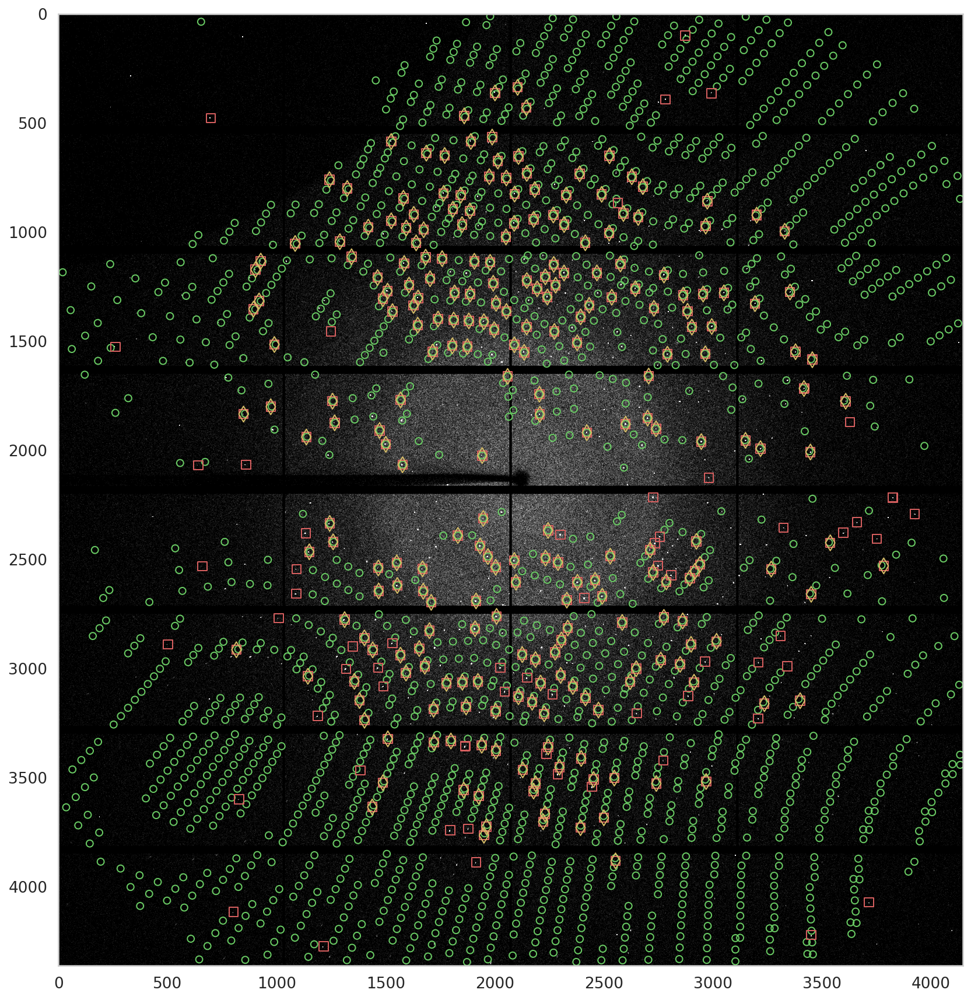

In [47]:
FR=100
im0=clean_image(sample_imgs[FR])

# Overlap for checking if two spots are the same
TP_OVERLAP=15

# spotfinder
strong_spf=spots_reflections[FR]
# predicted reflections
predicted=predicted_reflections[FR]

plt.figure(figsize=(15,15))

# Get TP
(matched_pred,matched_str)=get_matching_pairs(predicted, strong_spf,max_disdance=TP_OVERLAP)
TP=strong_spf[matched_str]

# pklot everything
plt.imshow(im0,cmap='gray',vmin=0,vmax=2)
# Green circles are the predicted spots positions
plt.scatter(predicted[:,0],predicted[:,1],s=35, facecolors='none', edgecolors='g')
# Red squares are the strong reflections from the spot finder
plt.scatter(strong_spf[:,0],strong_spf[:,1],s=60, facecolors='none', edgecolors='r',marker="s")
plt.scatter(TP[:,0],TP[:,1],s=90, facecolors='none', edgecolors='y',marker="d")

tmppred=np.asarray([1 if get_range(i,im0,dx=1).sum()>1 else 0 for i in predicted])
print("{:.2f}% of predicted reflections have measured counts > 1".format(100*tmppred.sum()/len(tmppred)))
tmppred=np.asarray([1 if get_range(i,im0,dx=1).sum()>2 else 0 for i in predicted])
print("Only {:.2f}% of predicted reflections have measured counts > 2\n".format(100*tmppred.sum()/len(tmppred)))

print("COLSPOT F1: {:.3f} | Precision: {:.3f} | Recall: {:.3f} | FP: {:.3f}\n\n".format(*get_metrics(strong_spf,predicted,max_overlap=TP_OVERLAP)))

plt.show()

In [27]:
list_TP=[]
list_FP=[]
list_FN=[]
list_F1=[]
list_PR=[]
list_RC=[]
prcounts_tr1=[]
prcounts_tr2=[]
prcounts_tr3=[]
colspot=[]
predspot=[]
counts500=[]
counts100=[]

# Overlap for checking if two spots are the same
TP_OVERLAP=15


FR=-1
for file in data_files:    
    sample_imgs=h5py.File(file, "r+")['entry']['data']['data']
    c=-1
    for imraw in tqdm(sample_imgs):
        FR+=1
        
        c+=1
        im0=clean_image(sample_imgs[c])

        # spotfinder
        strong_spf=spots_reflections[FR]
        colspot.append(len(strong_spf))
        # predicted reflections
        predicted=predicted_reflections[FR]
        predspot.append(len(predicted))

        # Get scoring metrics
        f1_score,precision_score,recall_score,TP,FP,FN=get_metrics_full(strong_spf,predicted,max_overlap=TP_OVERLAP)
        list_F1.append(f1_score)
        list_PR.append(precision_score)
        list_RC.append(recall_score)
        list_TP.append(TP)
        list_FP.append(FP)
        list_FN.append(FN)

        # Get the percentage of measurable predicetd spot
        # COUNTS>1
        tmppred=np.asarray([1 if get_range(i,im0,dx=1).sum()>1 else 0 for i in predicted])
        prcounts_tr1.append(100*tmppred.sum()/len(tmppred))
        # COUNTS>2
        tmppred=np.asarray([1 if get_range(i,im0,dx=1).sum()>2 else 0 for i in predicted])
        prcounts_tr2.append(100*tmppred.sum()/len(tmppred))
        # COUNTS>3
        tmppred=np.asarray([1 if get_range(i,im0,dx=1).sum()>3 else 0 for i in predicted])
        prcounts_tr3.append(100*tmppred.sum()/len(tmppred))
        
        # Number of pixels with count>500
        counts500.append(len(np.where(im0>500)[0]))
        # Number of pixels with count>100
        counts100.append(len(np.where(im0>100)[0]))
    

df_stat=pd.DataFrame(list(zip(
    
    list_F1,
    list_PR,
    list_RC,
    list_TP,
    list_FP,
    list_FN,
    colspot,
    predspot,
    prcounts_tr1,
    prcounts_tr2,
    prcounts_tr3,
    counts500,
    counts100
    
)), columns =[
    
    "F1",
    "Precision",
    "Recall",
    "True Positive",
    "False Positive",
    "False Negative",
    "Spots(COLSPOT)",
    "Spots(PREDICTED)",
    "Visible Spot (>1)",
    "Visible Spot (>2)",
    "Visible Spot (>3)",
    "Counts > 500",
    "Counts > 100"
    
    ])

100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 100/100 [01:08<00:00,  1.46it/s]


In [29]:
df_stat.agg(["mean", "median", "std","min","max"]).T

,mean,median,std,min,max
F1,0.309679,0.305075,0.067830,0.179681,0.477229
Precision,0.918137,0.934335,0.059201,0.541353,1.000000
Recall,0.189629,0.181312,0.052816,0.099350,0.345725
True Positive,201.061111,192.500000,57.196883,72.000000,372.000000
False Positive,21.321111,12.000000,24.287447,0.000000,130.000000
False Negative,859.074444,873.000000,68.523000,356.000000,977.000000
Spots(COLSPOT),222.382222,205.500000,76.369736,111.000000,483.000000
Spots(PREDICTED),1060.135556,1062.000000,51.045003,428.000000,1200.000000
Visible Spot (>1),95.270105,94.863217,3.212198,88.026820,100.000000
Visible Spot (>2),89.860561,88.622159,6.256340,78.221416,99.907493


<AxesSubplot:xlabel='Visible Spot (>2)', ylabel='False Positive'>

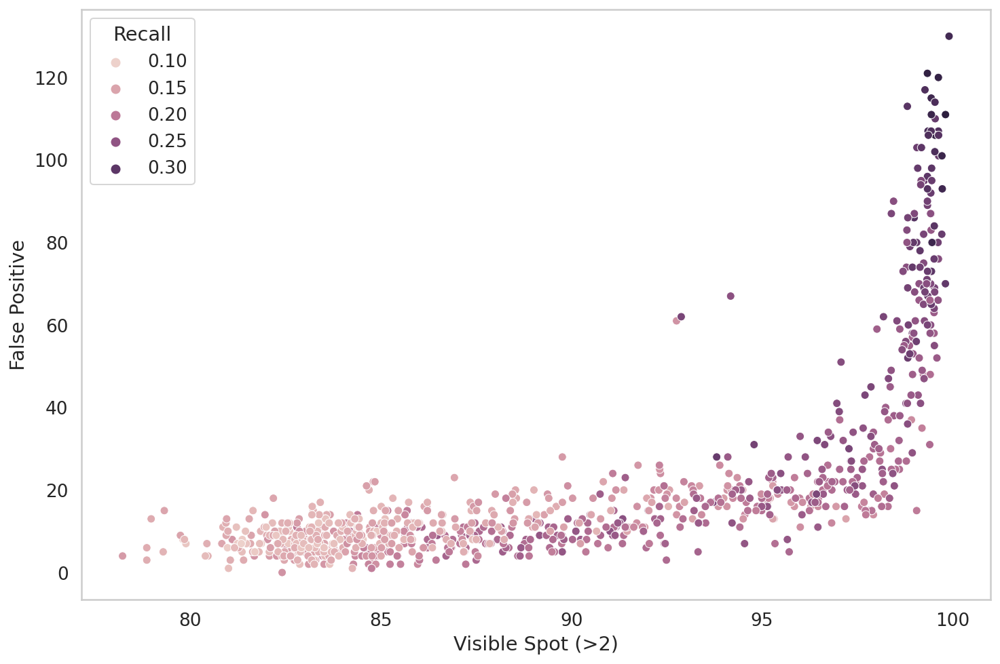

In [30]:
sns.scatterplot(data=df_stat, x="Visible Spot (>2)", y="False Positive",hue="Recall")

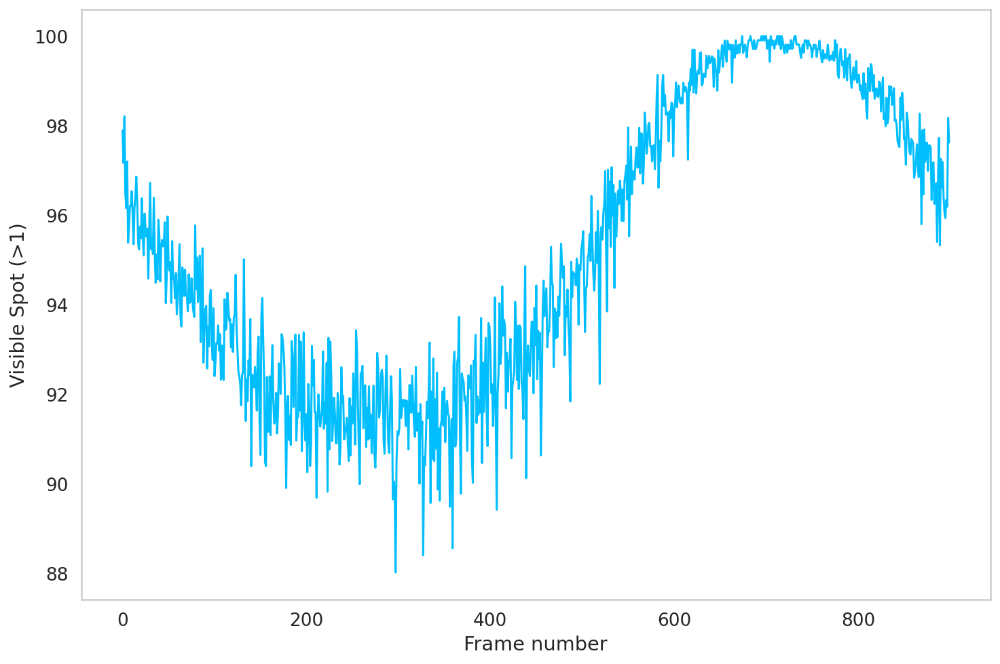

In [79]:
plt.ylabel("Visible Spot (>1)")
plt.xlabel("Frame number")
plt.plot(df_stat[["Visible Spot (>1)"]])

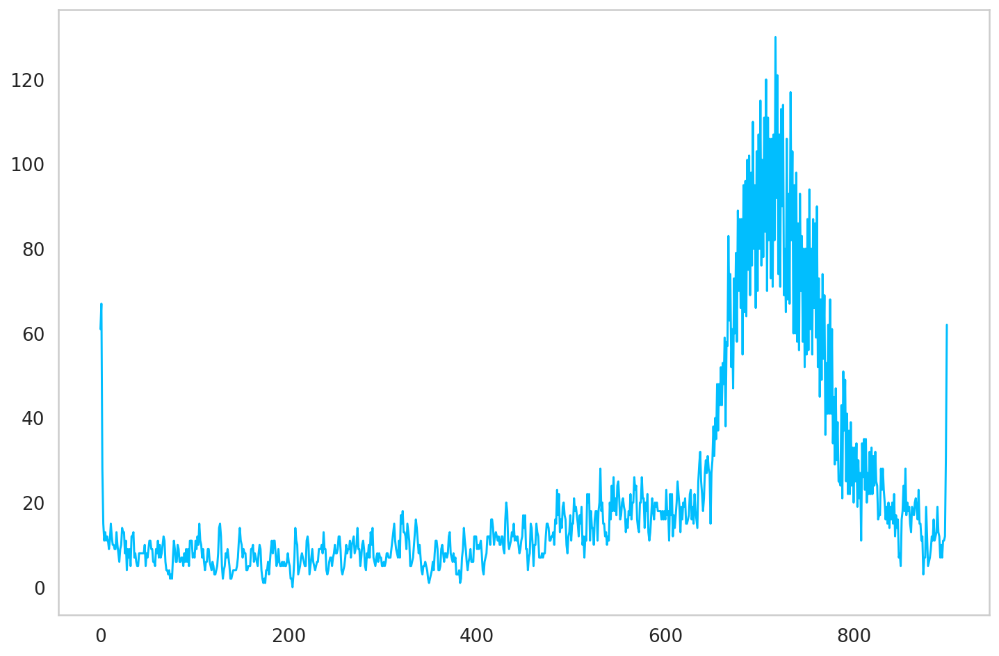

In [39]:
plt.plot(df_stat[["False Positive"]])

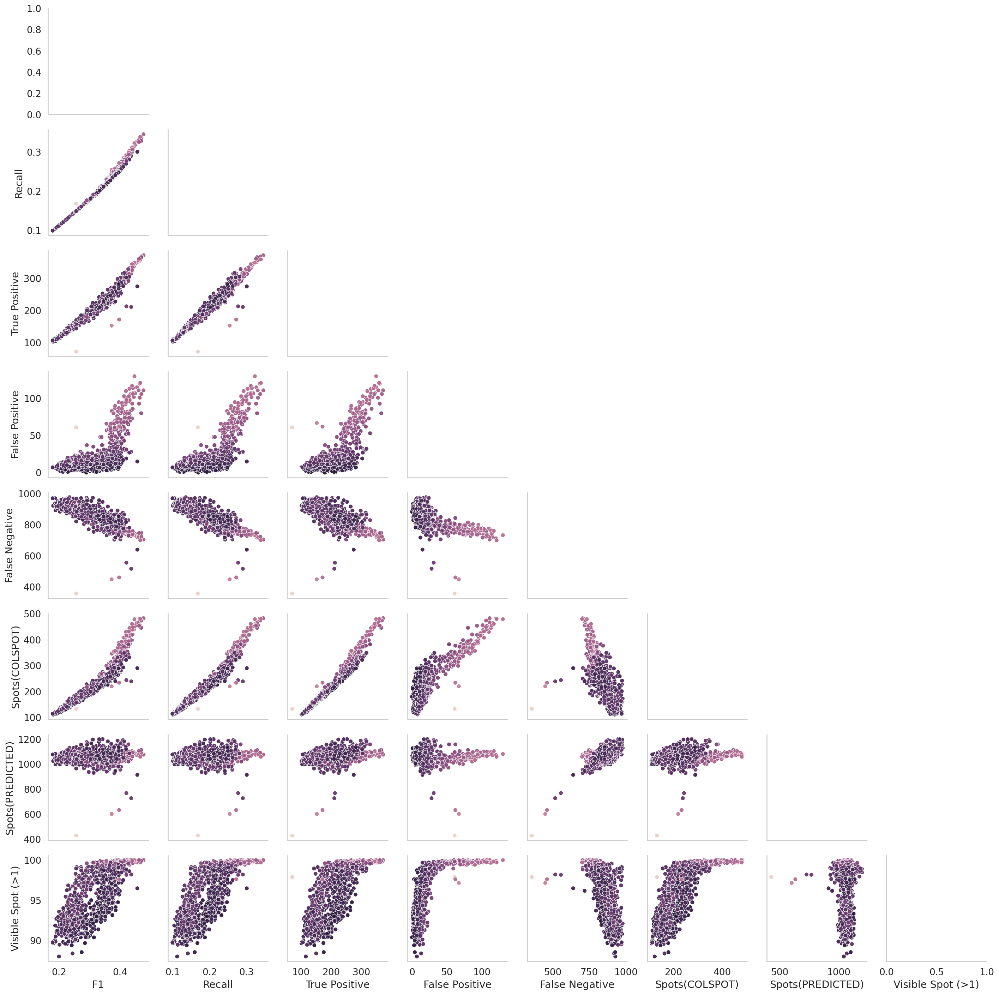

In [54]:
df=df_stat[["F1",
    "Precision",
    "Recall",
    "True Positive",
    "False Positive",
    "False Negative",
    "Spots(COLSPOT)",
    "Spots(PREDICTED)",
    "Visible Spot (>1)"]]


g = sns.PairGrid(df, hue="Precision", diag_sharey=False, corner=True)
g.map_lower(sns.scatterplot)
#g.map_diag(sns.kdeplot)

In [70]:
df["False Positive"].values.argmax()

717

99.91% of predicted reflections have measured counts > 1
Only 99.63% of predicted reflections have measured counts > 2

COLSPOT F1: 0.465 | Precision: 0.751 | Recall: 0.336 | FP: 120.000




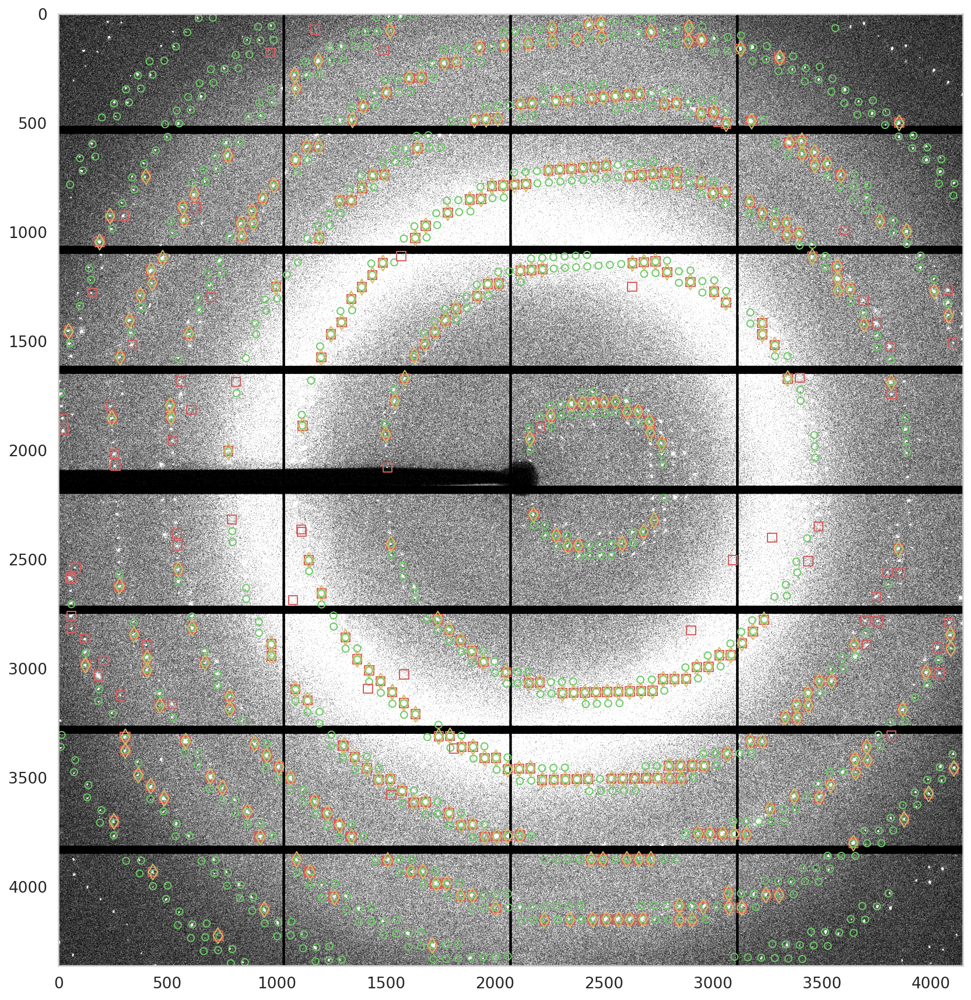

In [80]:
FR=707
batch_number=FR//100
IM_NUM=FR%100

sample_imgs=h5py.File(data_files[batch_number], "r+")['entry']['data']['data']
im0=clean_image(sample_imgs[IM_NUM])

# Overlap for checking if two spots are the same
TP_OVERLAP=15

# spotfinder
strong_spf=spots_reflections[FR]
# predicted reflections
predicted=predicted_reflections[FR]

plt.figure(figsize=(15,15))

# Get TP
(matched_pred,matched_str)=get_matching_pairs(predicted, strong_spf,max_disdance=TP_OVERLAP)
TP=strong_spf[matched_str]

# pklot everything
plt.imshow(im0,cmap='gray',vmin=0,vmax=2)
# Green circles are the predicted spots positions
plt.scatter(predicted[:,0],predicted[:,1],s=35, facecolors='none', edgecolors='g')
# Red squares are the strong reflections from the spot finder
plt.scatter(strong_spf[:,0],strong_spf[:,1],s=60, facecolors='none', edgecolors='r',marker="s")
plt.scatter(TP[:,0],TP[:,1],s=90, facecolors='none', edgecolors='y',marker="d")

tmppred=np.asarray([1 if get_range(i,im0,dx=1).sum()>1 else 0 for i in predicted])
print("{:.2f}% of predicted reflections have measured counts > 1".format(100*tmppred.sum()/len(tmppred)))
tmppred=np.asarray([1 if get_range(i,im0,dx=1).sum()>2 else 0 for i in predicted])
print("Only {:.2f}% of predicted reflections have measured counts > 2\n".format(100*tmppred.sum()/len(tmppred)))

print("COLSPOT F1: {:.3f} | Precision: {:.3f} | Recall: {:.3f} | FP: {:.3f}\n\n".format(*get_metrics(strong_spf,predicted,max_overlap=TP_OVERLAP)))

plt.show()

99.91% of predicted reflections have measured counts > 1
99.63% of predicted reflections have measured counts > 2
80.62% of predicted reflections have measured counts > 10



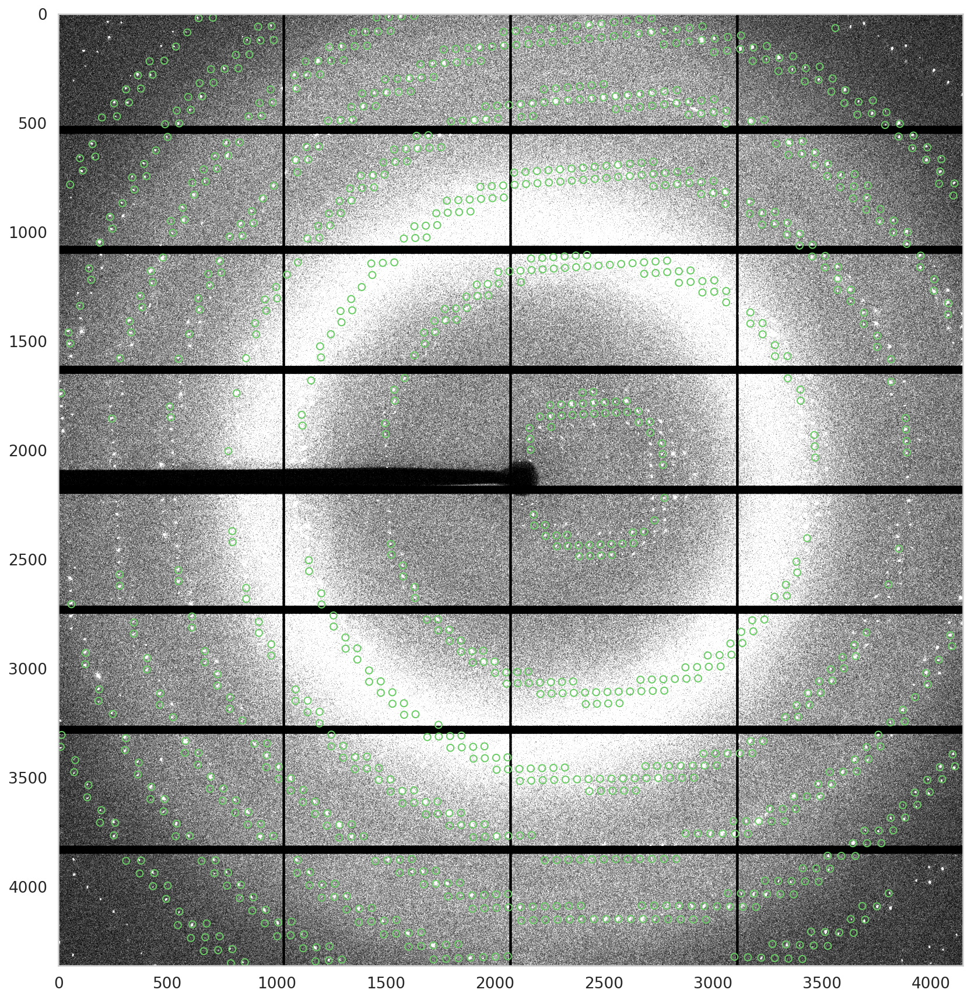

In [81]:
plt.figure(figsize=(15,15))

# Get TP
(matched_pred,matched_str)=get_matching_pairs(predicted, strong_spf,max_disdance=TP_OVERLAP)
TP=strong_spf[matched_str]

# pklot everything
plt.imshow(im0,cmap='gray',vmin=0,vmax=2)

# pklot everything
plt.imshow(im0,cmap='gray',vmin=0,vmax=2)
# Green circles are the predicted spots positions
plt.scatter(predicted[:,0],predicted[:,1],s=35, facecolors='none', edgecolors='g')

tmppred=np.asarray([1 if get_range(i,im0,dx=1).sum()>1 else 0 for i in predicted])
print("{:.2f}% of predicted reflections have measured counts > 1".format(100*tmppred.sum()/len(tmppred)))
tmppred=np.asarray([1 if get_range(i,im0,dx=1).sum()>2 else 0 for i in predicted])
print("{:.2f}% of predicted reflections have measured counts > 2".format(100*tmppred.sum()/len(tmppred)))
tmppred=np.asarray([1 if get_range(i,im0,dx=1).sum()>10 else 0 for i in predicted])
print("{:.2f}% of predicted reflections have measured counts > 10\n".format(100*tmppred.sum()/len(tmppred)))

## GET MORE DATA that are badly classified

In [122]:
newlist=[]
counter=0

for FR in range(10):
    im0=sample_images[FR]
    # predicted reflections
    predicted=predicted_reflections_array[FR]

    for testspot in np.vstack(np.where(im0>1)).T:
        #smallpatch=get_range(testspot[::-1],im0,dx=1)
        #if smallpatch[1,1]==smallpatch.sum():
        #    continue

        smallpatch=get_range(testspot[::-1],im0,dx=4)

        if smallpatch.shape!=(9,9) :
            continue

        smallpatch=smallpatch.ravel()

        #if max(smallpatch)<=255:
        #    smallpatch=smallpatch/1.
        #else:
        #    smallpatch=255*smallpatch/max(smallpatch)

        pred=model_svc_tuned.predict([ smallpatch ])[0]
        if pred==1 and len(np.where(distance.cdist([testspot],predicted, 'euclidean')[0]<12)[0])==0:
            counter+=1
            newlist.append(smallpatch.reshape(9,9))
            #print(pred,"   BIG NO")
            #print(smallpatch.reshape(9,9))
            #print("\n\n\n\n")

In [123]:
len(newlist)

147791

In [124]:
newlist = [ np.asarray(i).reshape(9,9) for i in set(list(map(tuple,[i.ravel() for i in newlist])))]

In [125]:
len(newlist)

147779

In [126]:
np.savez_compressed("../data_raw/falsepositive_lyso4_first10frames.npz",frames=newlist)

## Check with a new small model

In [254]:
FR=9
im0=sample_images[FR]
# predicted reflections
predicted=predicted_reflections_array[FR]

for testspot in np.vstack(np.where(im0>1)).T[:5]:
        #smallpatch=get_range(testspot[::-1],im0,dx=1)
        #if smallpatch[1,1]==smallpatch.sum():
        #    continue

    smallpatch=get_range(testspot[::-1],im0,dx=4)

    if smallpatch.shape!=(9,9) :
        continue

    smallpatch=smallpatch.ravel()

        #if max(smallpatch)<=255:
        #    smallpatch=smallpatch/1.
        #else:
        #    smallpatch=255*smallpatch/max(smallpatch)

    pred=model_svc_tuned.predict([ smallpatch ])[0]
    if pred==1 and len(np.where(distance.cdist([testspot],predicted, 'euclidean')[0]<12)[0])==0:
        print(pred,"   BIG NO")
        print(smallpatch.reshape(9,9))
        print("\n\n\n\n")